In [1]:
using Arpack
using LinearAlgebra
using CairoMakie
using LaTeXStrings
using Statistics
using Revise
include("/Users/avadali/Desktop/Desktop - Avi's Mac/Summer2024/AHC_code/Lattice_setup/lattice_BZ.jl")
include("/Users/avadali/Desktop/Desktop - Avi's Mac/Summer2024/AHC_code/Spinors/holo_spinors.jl")
include("/Users/avadali/Desktop/Desktop - Avi's Mac/Summer2024/AHC_code/3P_funcs/patch_methods.jl")

analytic_origin_3p (generic function with 1 method)

In [2]:
# general parameters
pd = 50
kappa = 1
m_kappa = 10^(-1) * kappa
w = 10^(-1) * m_kappa

0.010000000000000002

In [3]:
Nl = 3

3

In [4]:
# 3-patch parameters
delta = -1
vF = 0

0

<font size="12">BC as a function of Spacing</font>

In [8]:
function holo_bc_spacing(Nl, kappa, m_kappa, vF, delta, alpha_list, w, p, pd)
    temp_list = range(-2, 4, 10^3)
    spacing_list = 10 .^(temp_list)

    curvature_1 = Array{Float64}(undef, length(spacing_list))
    curvature_2 = Array{Float64}(undef, length(spacing_list))
    curvature_3 = Array{Float64}(undef, length(spacing_list))

    P = Figure(size=(3000, 2000), fontsize=30)

    for j in 1:length(alpha_list)
        alpha = alpha_list[j]
        for i in 1:length(spacing_list)
            spacing = (w / 2 / pd) / spacing_list[i]

            x = p * cos(10*pi/7)
            y = p * sin(10*pi/7)
            grid = reshape([x, y], (1, 2))

            curvature_1[i] = holo_patch_bc(grid, spacing, Nl, m_kappa, vF, delta, alpha)[1]
            curvature_2[i] = holo_spinor_bc(grid, spacing, Nl)[1]
            curvature_3[i] = bc_no_spinors(grid, spacing, vF, delta, alpha)[1]
        end
        ax1 = Axis(P[j, 1], title = string(angle(alpha) / pi), xlabel = L"\frac{1}{spacing}", ylabel = L"\Omega", xscale = log10)
        lines!(ax1, spacing_list, curvature_1)
        ax2 = Axis(P[j, 2], title = string(angle(alpha) / pi), xlabel = L"\frac{1}{spacing}", ylabel = L"\Omega", xscale = log10)
        lines!(ax2, spacing_list, curvature_2)
        ax2 = Axis(P[j, 3], title = string(angle(alpha) / pi), xlabel = L"\frac{1}{spacing}", ylabel = L"\Omega", xscale = log10)
        lines!(ax2, spacing_list, curvature_3)
    end
    axs1 = Axis(P[:, 1], title = L"\text{Holo 3P } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(axs1, label = false)
    hidespines!(axs1)

    axs2 = Axis(P[:, 2], title = L"\text{Parent } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(axs2, label = false)
    hidespines!(axs2)

    axs3 = Axis(P[:, 3], title = L"\text{Pure 3P } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(axs3, label = false)
    hidespines!(axs3)
    
    P
end

holo_bc_spacing (generic function with 1 method)

In [9]:
# parameters
alpha_list = (10^3) * [exp(pi/3 * im), exp(pi/4 * im), exp(pi/2 * im), exp(pi/2 * im) + 10^(-2)]
p = 10^(-14) * (w/2)

5.000000000000001e-17

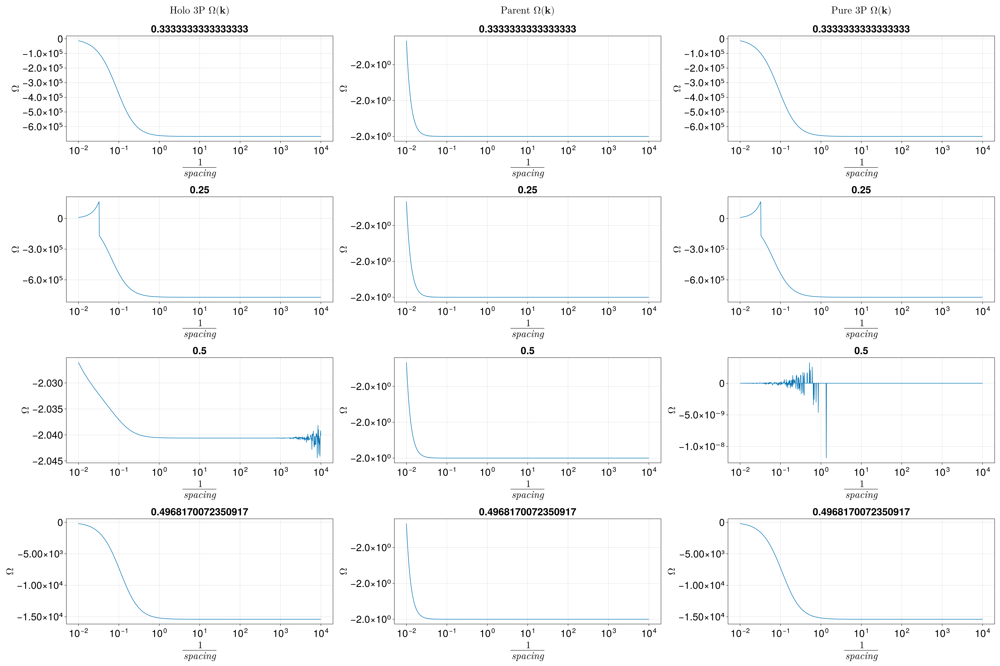

In [10]:
holo_bc_spacing(Nl, kappa, m_kappa, vF, delta, alpha_list, w, p, pd)

<font size="12">Large alpha limit</font>

In [8]:
lambda = 10^-5

1.0e-5

In [9]:
alpha_list = (10^5) * [exp(pi/3 * im), exp(pi/4 * im), exp(pi/2 * im), exp(pi/2 * im) + lambda]
p = 10^(-10) * w/2

5.000000000000001e-13

In [10]:
function holo_decoupled_comp(Nl, kappa, m_kappa, vF, delta, alpha_list, lambda, w, pd)
    # get an mBZ centered at the kappa-point
    grid = make_hex([10^(-16), 10^(-16)], w / 2, w / 2 / pd)

    spacing = 10^(-3) * (w / 2 / pd)

    fig = Figure(size=(2400, 800 * length(alpha_list)), fontsize=25)

    for j in 1:length(alpha_list)
        alpha = alpha_list[j]

        spinor_bc = holo_decoupled_bc(grid, spacing, Nl, m_kappa, vF, delta, alpha)

        patch_bc = holo_patch_bc(grid, spacing, Nl, m_kappa, vF, delta, alpha)

        cross = patch_bc - spinor_bc

        ax1 = Axis(fig[j, 1], title = string(round(angle(alpha) / pi, sigdigits=3)), 
        xlabel = L"k_x", ylabel = L"k_y")
        tricontourf!(ax1, grid[:, 1], grid[:, 2], patch_bc, colormap = :Spectral)
        X, ax1, tr1 = tricontourf(grid[:, 1], grid[:, 2], patch_bc, colormap = :Spectral)
        cb1 = Colorbar(fig[j, 2], tr1)

        ax3 = Axis(fig[j, 3], title = string(round(angle(alpha) / pi, sigdigits=3))
        , xlabel = L"k_x", ylabel = L"k_y")
        tricontourf!(ax3, grid[:, 1], grid[:, 2], spinor_bc, colormap = :Spectral)
        X, ax3, tr3 = tricontourf(grid[:, 1], grid[:, 2], spinor_bc, colormap = :Spectral)
        cb3 = Colorbar(fig[j, 4], tr3)

        ax3 = Axis(fig[j, 5], title = string(round(angle(alpha) / pi, sigdigits=3))
        , xlabel = L"k_x", ylabel = L"k_y")
        tricontourf!(ax3, grid[:, 1], grid[:, 2], cross, colormap = :Spectral)
        X, ax3, tr3 = tricontourf(grid[:, 1], grid[:, 2], cross, colormap = :Spectral)
        cb3 = Colorbar(fig[j, 6], tr3)
    end

    alpha = abs(alpha_list[1]) * (exp(im*pi/2) + lambda)

    spinor_bc = approx_holo_decoupled_bc(grid, spacing, Nl, m_kappa, delta, alpha, lambda)

    patch_bc = approx_holo_patch_bc(grid, spacing, Nl, m_kappa, delta, alpha, lambda)

    cross = patch_bc - spinor_bc

    ax1 = Axis(fig[length(alpha_list) + 1, 1], title = string(round(angle(alpha) / pi, sigdigits=3)), 
    xlabel = L"k_x", ylabel = L"k_y")
    tricontourf!(ax1, grid[:, 1], grid[:, 2], patch_bc, colormap = :Spectral)
    X, ax1, tr1 = tricontourf(grid[:, 1], grid[:, 2], patch_bc, colormap = :Spectral)
    cb1 = Colorbar(fig[length(alpha_list) + 1, 2], tr1)

    ax3 = Axis(fig[length(alpha_list) + 1, 3], title = string(round(angle(alpha) / pi, sigdigits=3))
    , xlabel = L"k_x", ylabel = L"k_y")
    tricontourf!(ax3, grid[:, 1], grid[:, 2], spinor_bc, colormap = :Spectral)
    X, ax3, tr3 = tricontourf(grid[:, 1], grid[:, 2], spinor_bc, colormap = :Spectral)
    cb3 = Colorbar(fig[length(alpha_list) + 1, 4], tr3)

    ax3 = Axis(fig[length(alpha_list) + 1, 5], title = string(round(angle(alpha) / pi, sigdigits=3))
    , xlabel = L"k_x", ylabel = L"k_y")
    tricontourf!(ax3, grid[:, 1], grid[:, 2], cross, colormap = :Spectral)
    X, ax3, tr3 = tricontourf(grid[:, 1], grid[:, 2], cross, colormap = :Spectral)
    cb3 = Colorbar(fig[length(alpha_list) + 1, 6], tr3)



    ax_c1 = Axis(fig[:, 1], title = L"\text{Holo 3P } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(ax_c1, label = false)
    hidespines!(ax_c1)

    ax_c2 = Axis(fig[:, 3], title = L"\text{Holo Decoupled } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(ax_c2, label = false)
    hidespines!(ax_c2)

    ax_c3 = Axis(fig[:, 5], title = L"\text{Holo Cross Term } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(ax_c3, label = false)
    hidespines!(ax_c3)

    fig
end

holo_decoupled_comp (generic function with 1 method)

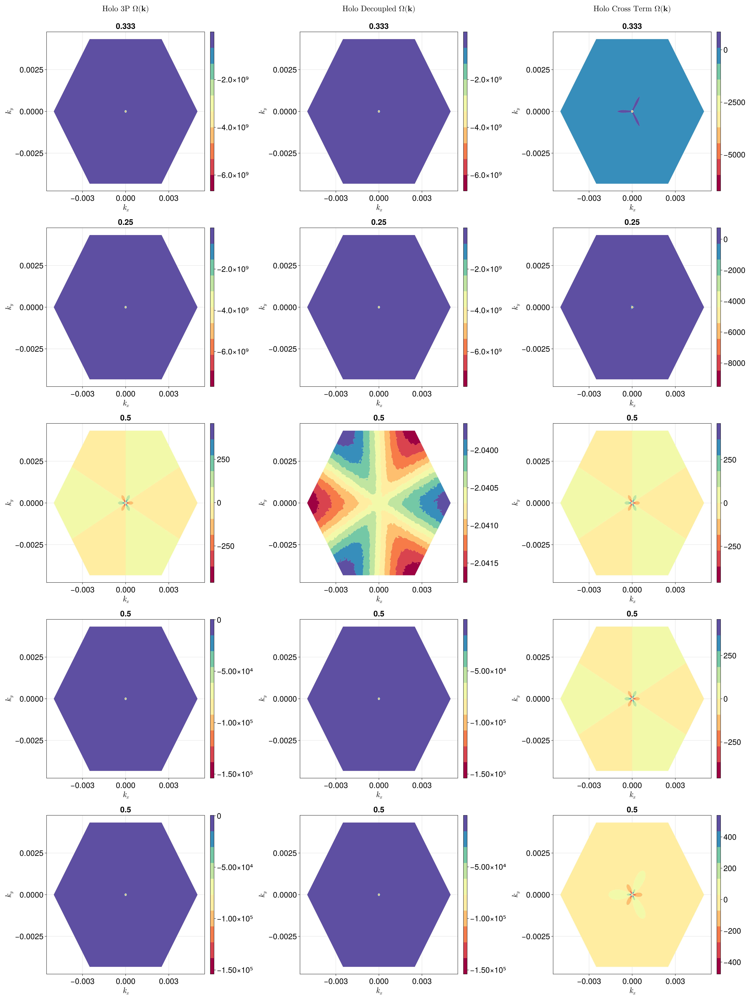

In [11]:
holo_decoupled_comp(Nl, kappa, m_kappa, vF, delta, alpha_list, lambda, w, pd)

In [12]:
function holo_decouple_theta_bc(Nl, kappa, m_kappa, vF, delta, alpha_list, lambda, w, theta, pd)
    p_list = 1.01 * range(10^(-14), 10^(-2), 10^3)
    curvature_ns_1 = Array{Float64}(undef, length(p_list))
    curvature_ns_2 = Array{Float64}(undef, length(p_list))
    curvature_ns_4 = Array{Float64}(undef, length(p_list))
    curvature_ns_5 = Array{Float64}(undef, length(p_list))
    curvature_ns_3 = Array{Float64}(undef, length(p_list))
    spacing = 10^(-2) * (w / 2 / pd)
    # create plot
    P = Figure(size=(3500, 2000), fontsize=30)
    for j in 1:length(alpha_list)
        alpha = alpha_list[j]
        for i in 1:length(p_list)
            # theta = theta_list[i]
            p = p_list[i]
            x = p * cos(theta)
            y = p * sin(theta)
            grid = reshape([x, y], (1, 2))

            curvature_ns_1[i] = holo_patch_bc(grid, spacing, Nl, m_kappa, vF, delta, alpha)[1]

            curvature_ns_2[i] = holo_decoupled_bc(grid, spacing, Nl, m_kappa, vF, delta, alpha)[1]

            curvature_ns_3[i] = abs(curvature_ns_1[i] - curvature_ns_2[i])

            curvature_ns_4[i] = holo_weighted_sum_bc(grid, spacing, Nl, m_kappa, vF, delta, alpha)[1]

            curvature_ns_5[i] = bc_no_spinors(grid, spacing, vF, delta, alpha)[1]

        end
        ax1 = Axis(P[j, 1], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
        lines!(ax1, p_list, curvature_ns_1)
        ax2 = Axis(P[j, 2], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
        lines!(ax2, p_list, curvature_ns_2)
        ax2 = Axis(P[j, 3], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
        lines!(ax2, p_list, curvature_ns_3)
        ax2 = Axis(P[j, 4], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
        lines!(ax2, p_list, curvature_ns_4)
        ax2 = Axis(P[j, 5], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
        lines!(ax2, p_list, curvature_ns_5)
    end

    alpha = abs(alpha_list[1]) * (exp(im * pi/2) + lambda)
    for i in 1:length(p_list)
        p = p_list[i]
        x = p * cos(theta)
        y = p * sin(theta)
        grid = reshape([x, y], (1, 2))

        curvature_ns_1[i] = approx_holo_patch_bc(grid, spacing, Nl, m_kappa, delta, alpha, lambda)[1]

        curvature_ns_2[i] = approx_holo_decoupled_bc(grid, spacing, Nl, m_kappa, delta, alpha, lambda)[1]

        curvature_ns_3[i] = abs(curvature_ns_1[i] - curvature_ns_2[i])

        curvature_ns_4[i] = approx_holo_weighted_sum_bc(grid, spacing, Nl, m_kappa, delta, alpha, lambda)[1]

        curvature_ns_5[i] = bc_no_spinors(grid, spacing, vF, delta, alpha)[1]

    end
    ax1 = Axis(P[length(alpha_list) + 1, 1], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
    lines!(ax1, p_list, curvature_ns_1)
    ax2 = Axis(P[length(alpha_list) + 1, 2], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
    lines!(ax2, p_list, curvature_ns_2)
    ax2 = Axis(P[length(alpha_list) + 1, 3], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
    lines!(ax2, p_list, curvature_ns_3)
    ax2 = Axis(P[length(alpha_list) + 1, 4], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
    lines!(ax2, p_list, curvature_ns_4)
    ax2 = Axis(P[length(alpha_list) + 1, 5], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
    lines!(ax2, p_list, curvature_ns_5)



    
    axs1 = Axis(P[:, 1], title = L"\text{Holo 3P } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(axs1, label = false)
    hidespines!(axs1)

    axs2 = Axis(P[:, 2], title = L"\text{Holo Decoupled } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(axs2, label = false)
    hidespines!(axs2)

    axs3 = Axis(P[:, 3], title = L"\text{Difference } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(axs3, label = false)
    hidespines!(axs3)

    axs4 = Axis(P[:, 4], title = L"\text{Weighted Sum Parent } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(axs4, label = false)
    hidespines!(axs4)

    axs5 = Axis(P[:, 5], title = L"\text{Pure 3P } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(axs5, label = false)
    hidespines!(axs5)
    P
end

holo_decouple_theta_bc (generic function with 1 method)

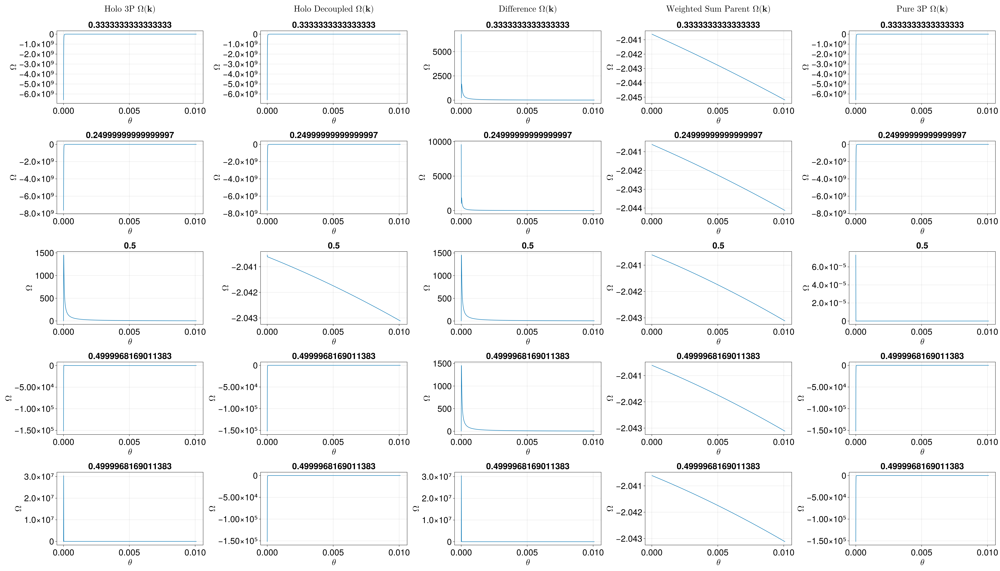

In [13]:
holo_decouple_theta_bc(Nl, kappa, m_kappa, vF, delta, alpha_list, lambda, w, pi/3, pd)

In [14]:
function origin_holo_decouple_alpha_bc(Nl, kappa, m_kappa, vF, delta, lambda, alpha_mag, w, pd)
    alpha_list = alpha_mag * exp.(im * range(0, 2*pi, 10^3))
    # p_list = 1.01 * range(10^(-14), 10^(-2), 10^3)
    curvature_ns_1 = Array{Float64}(undef, length(alpha_list))
    curvature_ns_2 = Array{Float64}(undef, length(alpha_list))
    curvature_ns_4 = Array{Float64}(undef, length(alpha_list))
    curvature_ns_5 = Array{Float64}(undef, length(alpha_list))
    curvature_ns_3 = Array{Float64}(undef, length(alpha_list))
    spacing = 10^(-2) * (w / 2 / pd)

    p = 10^(-14)
    theta = pi/3
    x = p * cos(theta)
    y = p * sin(theta)
    grid = reshape([x, y], (1, 2))
    # create plot
    P = Figure(size=(3500, 2000), fontsize=30)
    for i in 1:length(alpha_list)
        alpha = alpha_list[i]

        curvature_ns_1[i] = holo_patch_bc(grid, spacing, Nl, m_kappa, vF, delta, alpha)[1]

        curvature_ns_2[i] = holo_decoupled_bc(grid, spacing, Nl, m_kappa, vF, delta, alpha)[1]

        curvature_ns_3[i] = abs(curvature_ns_1[i] - curvature_ns_2[i])

        curvature_ns_4[i] = holo_weighted_sum_bc(grid, spacing, Nl, m_kappa, vF, delta, alpha)[1]

        curvature_ns_5[i] = bc_no_spinors(grid, spacing, vF, delta, alpha)[1]
        # for i in 1:length(p_list)
        #     # theta = theta_list[i]
        #     p = p_list[i]
        #     x = p * cos(theta)
        #     y = p * sin(theta)
        #     grid = reshape([x, y], (1, 2))

        #     curvature_ns_1[i] = holo_patch_bc(grid, spacing, Nl, m_kappa, vF, delta, alpha)[1]

        #     curvature_ns_2[i] = holo_decoupled_bc(grid, spacing, Nl, m_kappa, vF, delta, alpha)[1]

        #     curvature_ns_3[i] = abs(curvature_ns_1[i] - curvature_ns_2[i])

        #     curvature_ns_4[i] = holo_weighted_sum_bc(grid, spacing, Nl, m_kappa, vF, delta, alpha)[1]

        #     curvature_ns_5[i] = bc_no_spinors(grid, spacing, vF, delta, alpha)[1]

        # end
    end
    ax1 = Axis(P[1, 1], xlabel = L"\theta", ylabel = L"\Omega")
    lines!(ax1, angle.(alpha_list), curvature_ns_1)
    ax2 = Axis(P[1, 2], xlabel = L"\theta", ylabel = L"\Omega")
    lines!(ax2, angle.(alpha_list), curvature_ns_2)
    ax2 = Axis(P[1, 3], xlabel = L"\theta", ylabel = L"\Omega")
    lines!(ax2, angle.(alpha_list), curvature_ns_3)
    ax2 = Axis(P[1, 4], xlabel = L"\theta", ylabel = L"\Omega")
    lines!(ax2, angle.(alpha_list), curvature_ns_4)
    ax2 = Axis(P[1, 5], xlabel = L"\theta", ylabel = L"\Omega")
    lines!(ax2, angle.(alpha_list), curvature_ns_5)

    # alpha = abs(alpha_list[1]) * (exp(im * pi/2) + lambda)
    # for i in 1:length(p_list)
    #     p = p_list[i]
    #     x = p * cos(theta)
    #     y = p * sin(theta)
    #     grid = reshape([x, y], (1, 2))

    #     curvature_ns_1[i] = approx_holo_patch_bc(grid, spacing, Nl, m_kappa, delta, alpha, lambda)[1]

    #     curvature_ns_2[i] = approx_holo_decoupled_bc(grid, spacing, Nl, m_kappa, delta, alpha, lambda)[1]

    #     curvature_ns_3[i] = abs(curvature_ns_1[i] - curvature_ns_2[i])

    #     curvature_ns_4[i] = approx_holo_weighted_sum_bc(grid, spacing, Nl, m_kappa, delta, alpha, lambda)[1]

    #     curvature_ns_5[i] = bc_no_spinors(grid, spacing, vF, delta, alpha)[1]

    # end
    # ax1 = Axis(P[length(alpha_list) + 1, 1], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
    # lines!(ax1, p_list, curvature_ns_1)
    # ax2 = Axis(P[length(alpha_list) + 1, 2], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
    # lines!(ax2, p_list, curvature_ns_2)
    # ax2 = Axis(P[length(alpha_list) + 1, 3], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
    # lines!(ax2, p_list, curvature_ns_3)
    # ax2 = Axis(P[length(alpha_list) + 1, 4], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
    # lines!(ax2, p_list, curvature_ns_4)
    # ax2 = Axis(P[length(alpha_list) + 1, 5], title = string(angle(alpha) / pi), xlabel = L"\theta", ylabel = L"\Omega")
    # lines!(ax2, p_list, curvature_ns_5)



    
    axs1 = Axis(P[:, 1], title = L"\text{Holo 3P } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(axs1, label = false)
    hidespines!(axs1)

    axs2 = Axis(P[:, 2], title = L"\text{Holo Decoupled } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(axs2, label = false)
    hidespines!(axs2)

    axs3 = Axis(P[:, 3], title = L"\text{Difference } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(axs3, label = false)
    hidespines!(axs3)

    axs4 = Axis(P[:, 4], title = L"\text{Weighted Sum Parent } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(axs4, label = false)
    hidespines!(axs4)

    axs5 = Axis(P[:, 5], title = L"\text{Pure 3P } \Omega (\textbf{k})", titlegap = 60)
    hidedecorations!(axs5, label = false)
    hidespines!(axs5)
    P
end

origin_holo_decouple_alpha_bc (generic function with 1 method)

In [15]:
alpha_mag = 10^3

1000

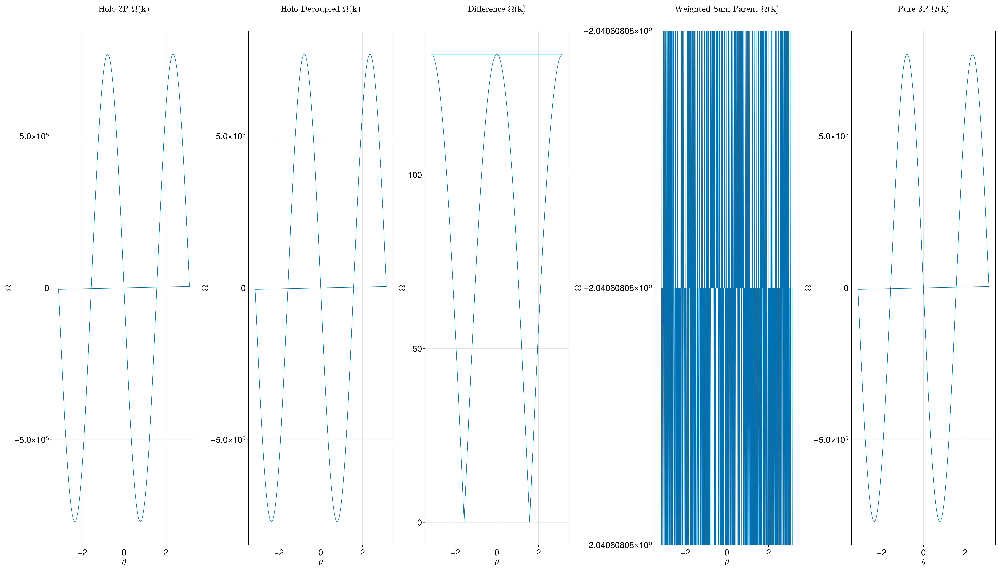

In [16]:
origin_holo_decouple_alpha_bc(Nl, kappa, m_kappa, vF, delta, lambda, alpha_mag, w, pd)

In [14]:
function weights(theta, delt, alpha_list)
    q_list = range(-10^-3, 10^-3, 10^3)
    P = Figure(size=(3500, 2000), fontsize=30)
    for i in 1:length(alpha_list)
        alph = alpha_list[i]
        c_list = Array{ComplexF64}(undef, 3, length(q_list))
        for j in 1:length(q_list)
            q = 10 .^q_list[j]
            ham = H_mft(q, theta, delt, alph)
            grounds = normalize(eigvecs(Hermitian(ham))[:, 1])
            c_list[:, j] = grounds
        end
        ax1 = Axis(P[i, 1], title = string(angle(alph) / pi), xlabel = L"q", ylabel = L"{|C_1|}^2")
        ax2 = Axis(P[i, 2], title = string(angle(alph) / pi), xlabel = L"q", ylabel = L"{|C_3|}^2")
        ax3 = Axis(P[i, 3], title = string(angle(alph) / pi), xlabel = L"q", ylabel = L"{|C_5|}^2")
        lines!(ax1, q_list, abs.(c_list[1, :]).^2)
        lines!(ax2, q_list, abs.(c_list[2, :]).^2)
        lines!(ax3, q_list, abs.(c_list[3, :]).^2)
    end
    P
end
            

weights (generic function with 1 method)

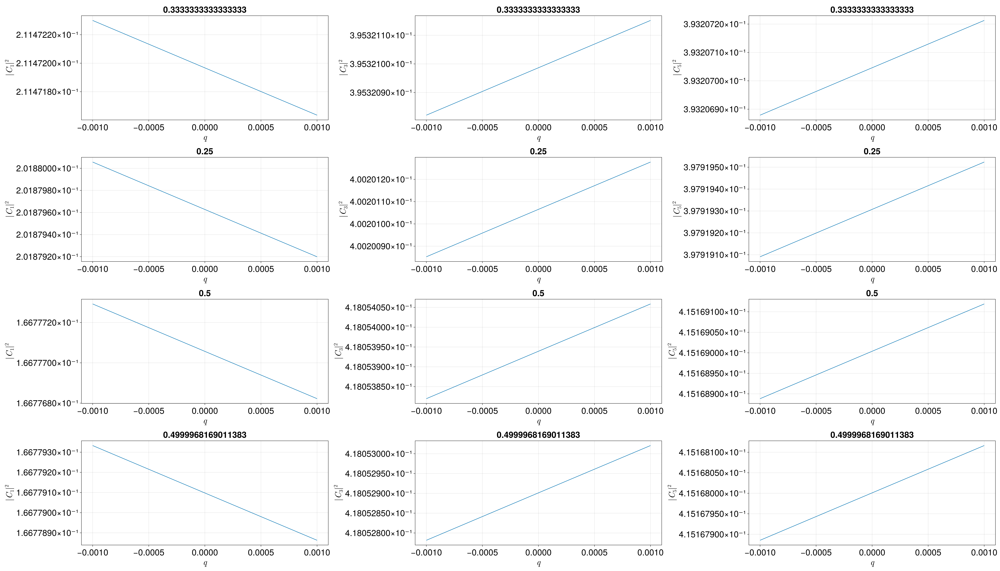

In [15]:
weights(p, delta, alpha_list)

<font size="12">Medium alpha limit</font>

In [16]:
lambda = 10^(-4)

0.0001

In [17]:
# parameters
alpha_list = (300) * [exp(pi/3 * im), exp(pi/4 * im), exp(pi/2 * im), exp(pi/2 * im) + lambda]
p = 10^(-14) * (w/2)

5.000000000000001e-17

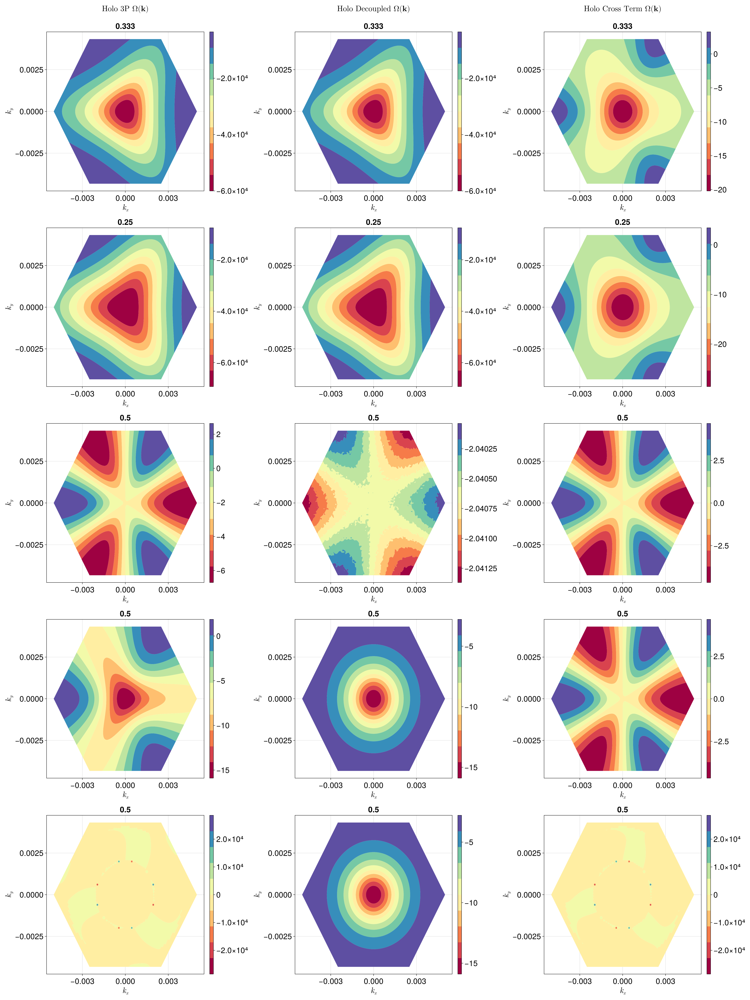

In [18]:
holo_decoupled_comp(Nl, kappa, m_kappa, vF, delta, alpha_list, lambda, w, pd)

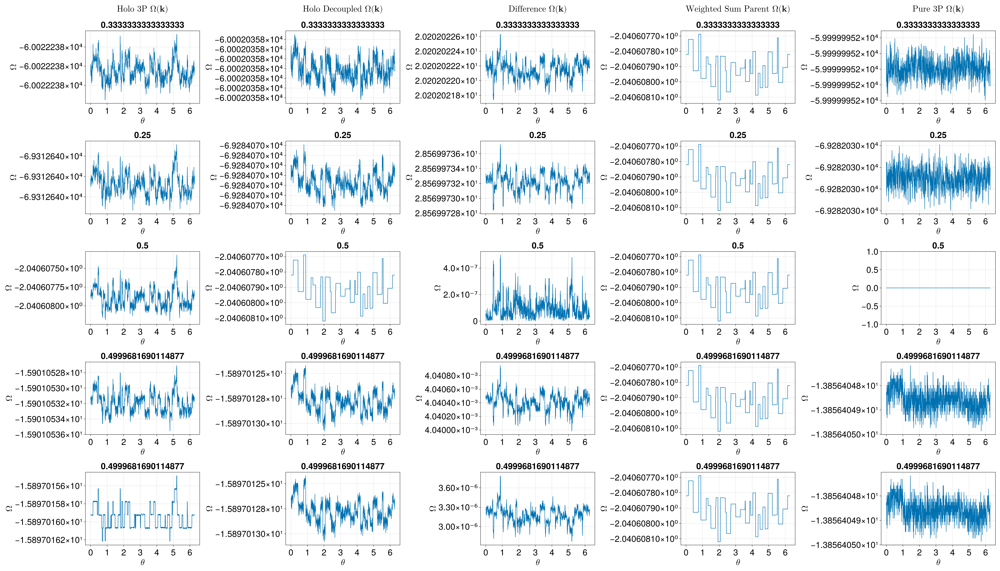

In [19]:
holo_decouple_theta_bc(Nl, kappa, m_kappa, vF, delta, alpha_list, lambda, w, p, pd)

<font size="12">Small alpha limit</font>

In [20]:
lambda = 10^(-5)

1.0e-5

In [21]:
# parameters
alpha_list = (10) * [exp(pi/3 * im), exp(pi/4 * im), exp(pi/2 * im), exp(pi/2 * im) + lambda]
p = 10^(-14) * (w / 2)

5.000000000000001e-17

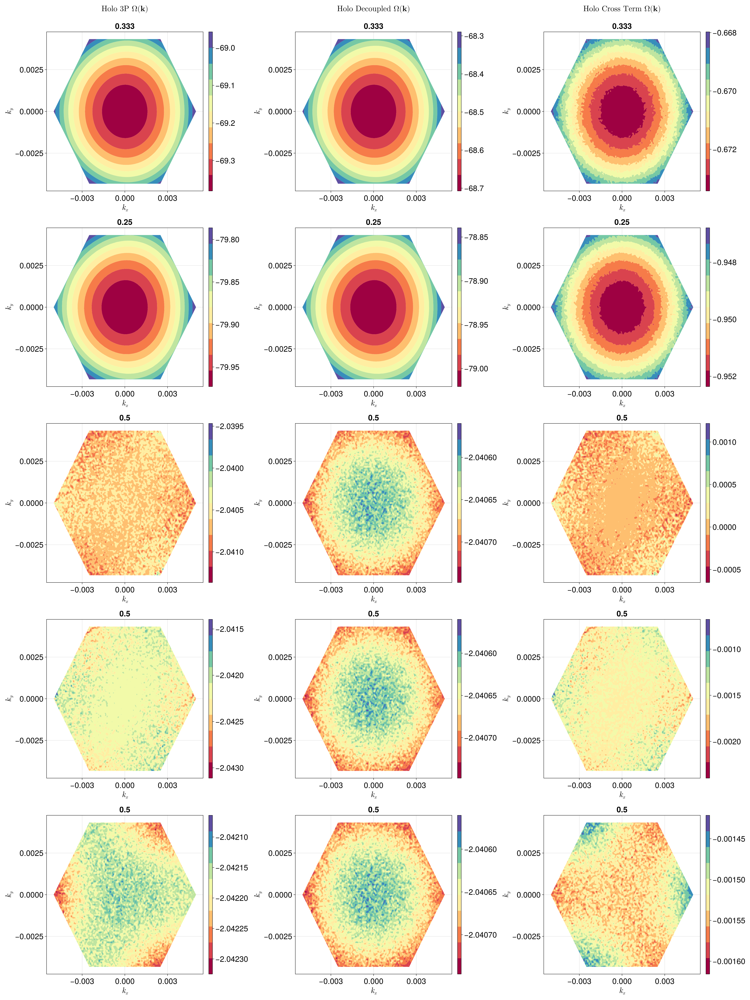

In [22]:
holo_decoupled_comp(Nl, kappa, m_kappa, vF, delta, alpha_list, lambda, w, pd)

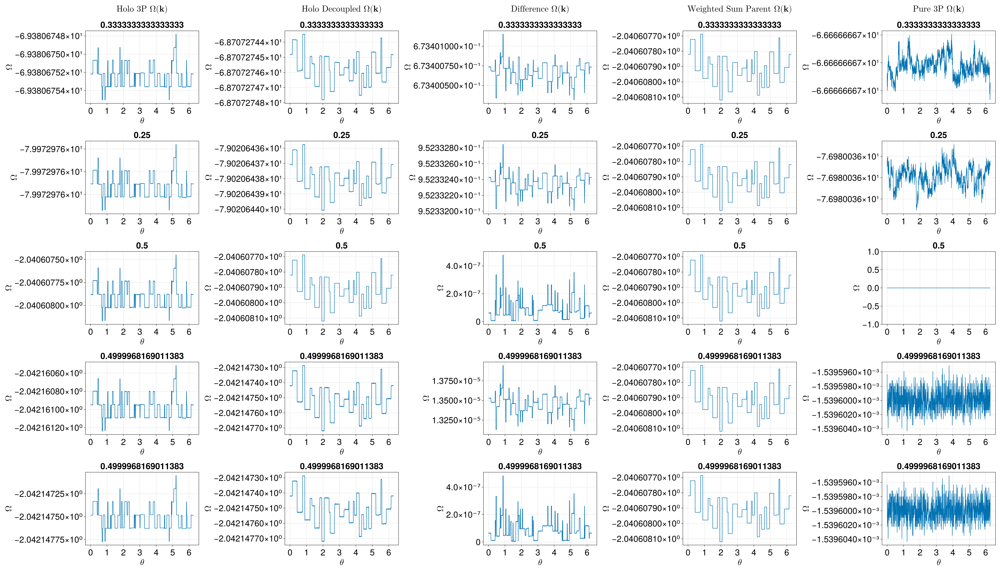

In [23]:
holo_decouple_theta_bc(Nl, kappa, m_kappa, vF, delta, alpha_list, lambda, w, p, pd)